In [1]:
import numpy as np
import cv2

images = [cv2.imread('data/hyu_{}.jpeg'.format(i)) for i in range(3)]
grays = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in images]


sift = cv2.xfeatures2d.SIFT_create()
kps = []
descs = []
for gray in grays:
    kp, desc = sift.detectAndCompute(gray, None)
    kps.append(kp)
    descs.append(desc)

bf = cv2.BFMatcher()
matches1 = bf.match(descs[0], descs[1])     # between image 0 and image 1
matches2 = bf.match(descs[2], descs[1])     # between image 2 and image 1

[ WARN:0@0.053] global shadow_sift.hpp:15 SIFT_create DEPRECATED: cv.xfeatures2d.SIFT_create() is deprecated due SIFT tranfer to the main repository. https://github.com/opencv/opencv/issues/16736


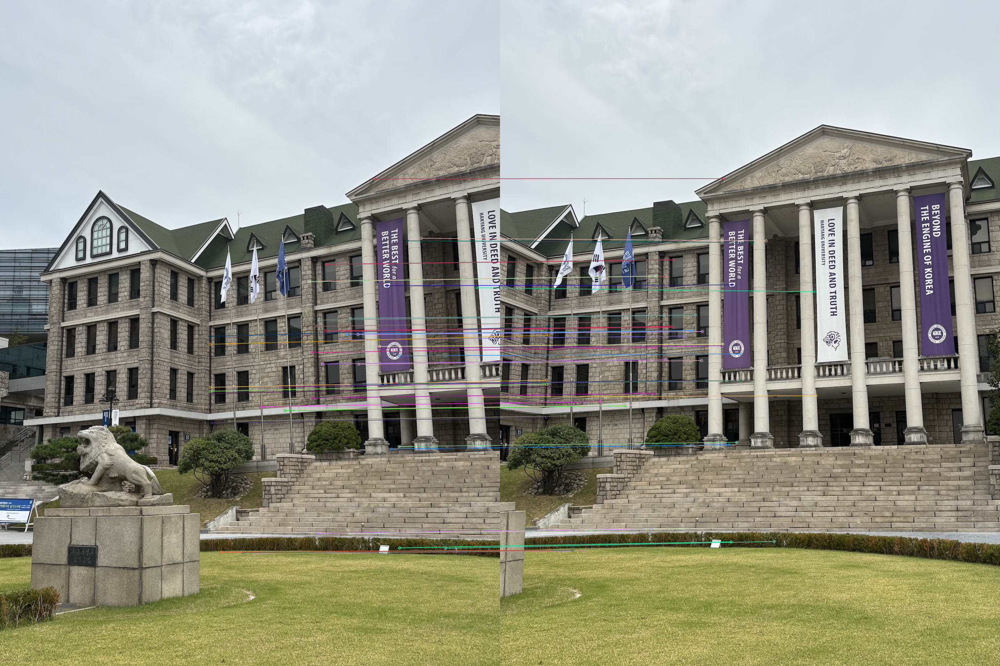

In [2]:

sorted_matches = sorted(matches1, key = lambda x : x.distance)
res = cv2.drawMatches(images[0], kps[0], images[1], kps[1], sorted_matches[:50], None, flags = 2)

from PIL import Image
Image.fromarray(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

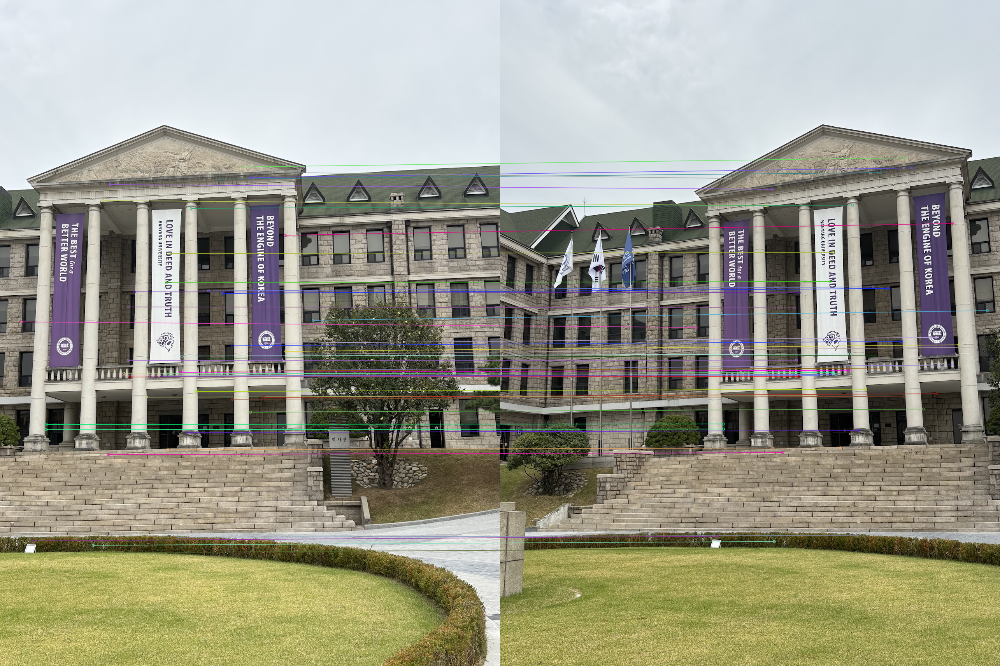

In [3]:
sorted_matches = sorted(matches2, key = lambda x : x.distance)
res = cv2.drawMatches(images[2], kps[2], images[1], kps[1], sorted_matches[:50], None, flags = 2)

from PIL import Image
Image.fromarray(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

In [4]:
height, width, _ = images[0].shape
result = np.zeros((height, width * 3, 3), dtype = np.uint8)

# Stitch image2 to image1
src = np.float32([kps[2][m.queryIdx].pt for m in matches2]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches2]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)

# Prepare pixel coordinates in image2
before_2 = []
for x in range(images[2].shape[1]):
    for y in range(images[2].shape[0]):
        point = [x, y, 1]
        before_2.append(point)
before_2 = np.array(before_2).transpose()

# [TODO] Calculate coordinates for each pixel in image2 to image1
after_2 = H @ before_2
after_2 = after_2 / after_2[2, :]
after_2 = after_2[:2, :]
after_2 = np.round(after_2, 0).astype(int)


for pt1, pt2 in zip(before_2[:2, :].transpose(), after_2.transpose()):
    if pt2[1] >= height:
        continue

    if np.sum(pt2 < 0) >= 1:
        continue

    result[pt2[1], width+pt2[0]] = images[2][pt1[1], pt1[0]]


# Stitch image0 to image1
src = np.float32([kps[0][m.queryIdx].pt for m in matches1]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches1]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)


# Prepare pixel coordinates in image0
before_2 = []
for x in range(images[0].shape[1]):
    for y in range(images[0].shape[0]):
        point = [x, y, 1]
        before_2.append(point)
before_2 = np.array(before_2).transpose()

# [TODO] Calculate coordinates for each pixel in image0 to image1
after_2 = H @ before_2
after_2 = after_2 / after_2[2, :]
after_2 = after_2[:2, :]
after_2 = after_2.astype(int)
after_2[0] += width

for pt1, pt2 in zip(before_2[:2, :].transpose(), after_2.transpose()):
    if pt2[1] < 0 or pt2[1] >= height:
        continue

    if any(pt2 < 0):
        continue

    result[pt2[1], pt2[0]] = images[0][pt1[1], pt1[0]]
result[0:height, width:width*2] = images[1]

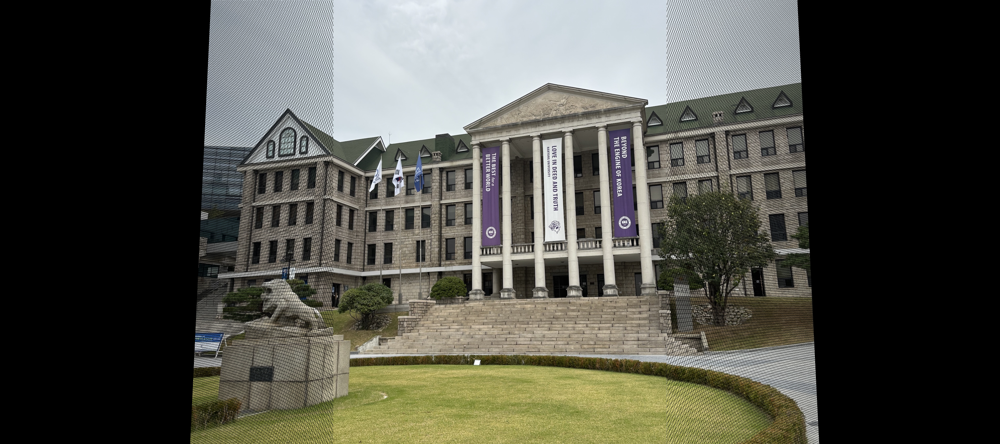

In [5]:
from PIL import Image
Image.fromarray(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))

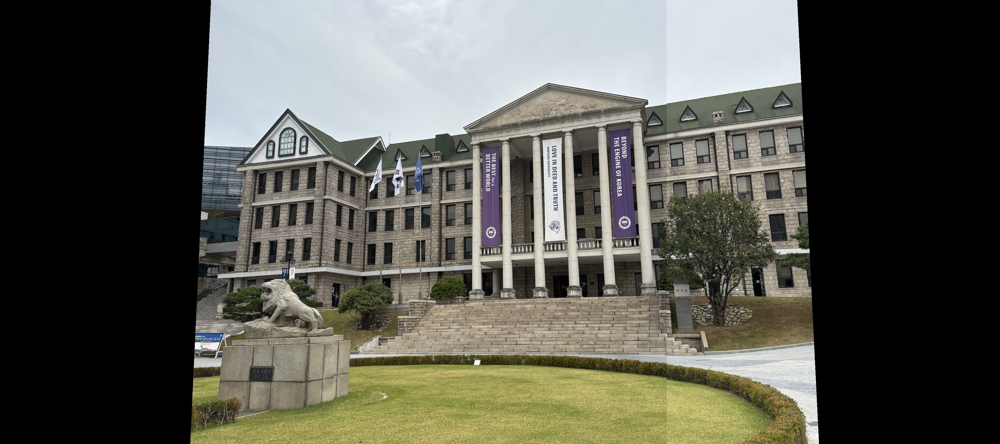

In [6]:
from scipy.interpolate import RegularGridInterpolator

height, width, _ = images[0].shape
result = np.zeros((height, width * 3, 3), dtype = np.uint8)

# Stitch image2 to image1
src = np.float32([kps[2][m.queryIdx].pt for m in matches2]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches2]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)
H_inv = np.linalg.inv(H)

# Prepare pixel coordinates
before_2 = np.stack(np.meshgrid(range(-width, 2 * width), range(height)))  # (2, 3W, H)
before_2 = before_2.reshape((2, -1))  # (2, 3HW)
before_2 = np.vstack((before_2, np.ones(before_2.shape[1])))  # (3, 3HW)
before_2 = before_2.astype(int)

# Calculate coordinates for each pixel in image1 to image2
after_2 = H_inv @ before_2
after_2 = after_2 / after_2[2, :]
after_2 = after_2[:2, :]  # (2, 3HW)

# Refine & reshape
idx = (0 <= after_2[0]) & (after_2[0] < width) & (0 <= after_2[1]) & (after_2[1] < height)
before_2 = before_2[:, idx]
after_2 = after_2[:, idx]
before_2 = before_2.transpose()  # (N, 2)
after_2 = after_2.transpose()  # (N, 2)

# Interpolate pixel values
interpolator = RegularGridInterpolator(
    (range(width), range(height)),
    images[2].transpose(1, 0, 2),
    bounds_error=False,
    method="cubic",
    fill_value=0,
)
after_vals_2 = interpolator(after_2)  # (N,)
result[before_2[:, 1], before_2[:, 0] + width] = after_vals_2.astype(np.uint8)


# Stitch image0 to image1
src = np.float32([kps[0][m.queryIdx].pt for m in matches1]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches1]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)
H_inv = np.linalg.inv(H)

# Prepare pixel coordinates
before_0 = np.stack(np.meshgrid(range(-width, 2 * width), range(height)))  # (2, 3W, H)
before_0 = before_0.reshape((2, -1))  # (2, 3HW)
before_0 = np.vstack((before_0, np.ones(before_0.shape[1])))  # (3, 3HW)
before_0 = before_0.astype(int)

# Calculate coordinates for each pixel in image1 to image0
after_0 = H_inv @ before_0
after_0 = after_0 / after_0[2, :]
after_0 = after_0[:2, :]  # (2, 3HW)

# Refine & reshape
idx = (0 <= after_0[0]) & (after_0[0] < width) & (0 <= after_0[1]) & (after_0[1] < height)
before_0 = before_0[:, idx]
after_0 = after_0[:, idx]
before_0 = before_0.transpose()  # (N, 2)
after_0 = after_0.transpose()  # (N, 2)

# Interpolate pixel values
interpolator = RegularGridInterpolator(
    (range(width), range(height)),
    images[0].transpose(1, 0, 2),
    bounds_error=False,
    method="cubic",
    fill_value=0,
)
after_vals_0 = interpolator(after_0)    # (N,)
result[before_0[:, 1], before_0[:, 0] + width] = after_vals_0.astype(np.uint8)

# Draw image1
result[0:height, width:width*2] = images[1]

Image.fromarray(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))

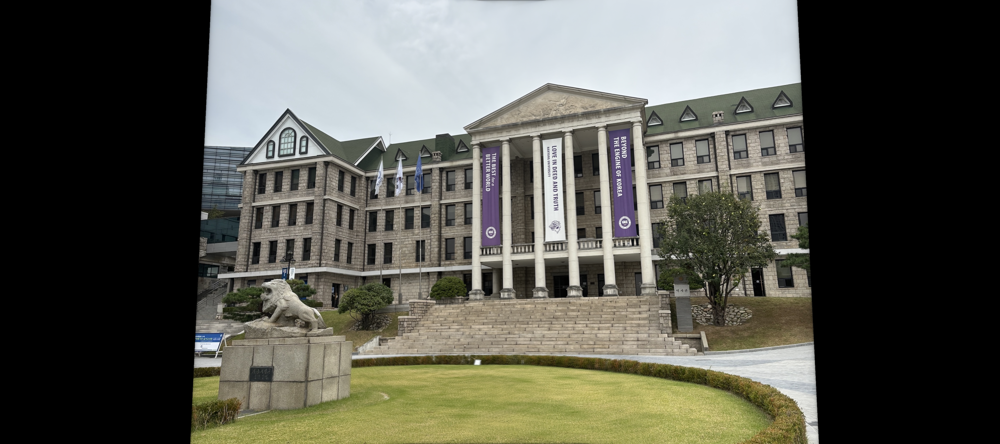

In [7]:
result = np.zeros((height, width * 3, 3))
weight_sum = np.ones((height, width * 3), dtype=int)
weight = np.zeros((height, width), dtype=int)
for x in range(width):
    for y in range(height):
        weight[y][x] = min(x, width - 1 - x, y, height - 1 - y) + 1

for b, a, v in zip(before_2, after_2, after_vals_2):
    a = np.round(a).astype(int).clip(0, [width - 1, height - 1])
    result[b[1], b[0] + width] += v * weight[a[1], a[0]]
    weight_sum[b[1], b[0] + width] += weight[a[1], a[0]]
    
for b, a, v in zip(before_0, after_0, after_vals_0):
    a = np.round(a).astype(int).clip(0, [width - 1, height - 1])
    result[b[1], b[0] + width] += v * weight[a[1], a[0]]
    weight_sum[b[1], b[0] + width] += weight[a[1], a[0]]

result[0:height, width:width*2] += images[1] * weight[..., None]
weight_sum[0:height, width:width*2] += weight

for x in range(width * 3):
    for y in range(height):
        if weight_sum[y][x] == 0:
            continue
        result[y][x] /= weight_sum[y][x]

result = result.clip(0, 255).astype(np.uint8)
Image.fromarray(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))